## SNIRH Brazil and Telemetering Fluvial Station Distribution

This library uses API access to the National Water Resources Information System from brazilian's National Water Agency (ANA). The system can be explored through https://www.snirh.gov.br/hidroweb/mapa. However, retrieving data for many stations at once is not allowed/implemented through their end user interface. Through the API access, this automation can be done.

Registration for the system's API can be done through https://www.ana.gov.br/hidrowebservice/swagger-ui.html after obtaining a password from the system's administration. Therefore, for now, the access is restrict.

<font color ='orange'>Users who wish to access the API data and information in an automated way should send an email to <font color ='magenta'>hidro@ana.gov.br</font> with the subject line “[Fill in with your CPF or CNPJ] - Request for access to the HidroWebService API for data consumption”.</font>

A guide to the portal's access is available at: https://www.gov.br/ana/pt-br/assuntos/monitoramento-e-eventos-criticos/monitoramento-hidrologico/orientacoes-manuais/manuais/manual-hidrowebservice_publica.pdf

The functions and scripts here used were designed to run through Python Notebooks or through a WEB Environment, due to the usage of Folium Maps to display and interact with data.

<font color ='orange'>Credentials must be provided in the src/config.env file</font>.

In [1]:
# General import and initialization
# User must provide the credentials for HidroWeb access in the src/config.env file.
# User must provide the credentials for OpenTopography access in the src/config.env file

from src import *

# Load static data
gdf_subbasins = load_subbasins()

<font color='orange'>In the case that the credentials could not be obtained for Hidroweb,
sub-basin station inventory (obtained through the <font color='magenta'>get_telemstat_subbasin()</font>) and station flow series data (obtained through <font color='magenta'>get_telemstat_flowseries_all()</font> and filtered and saved after <font color='magenta'>filter_and_save_successfull_flowseries()</font> are available in the following link:
</font>
https://drive.google.com/drive/folders/1J7Hz45cXuulkpahaD_JpVK_oGygqmJvg?usp=drive_link

To use them, select a target sub-basin of analysis (through <font color='magenta'>gdf_subbasin, ID_SUBBASIN = choose_subbasin(SUB_BASINS_PATH)</font>) equal to the two digit number in the beginning of the file name.

#### 1: Get access to SNIRH (HIDROWEB ANA): return a token of access.

The <font color='magenta'>get_access_token()</font> is used connect to HIDROWEB API.

In [ ]:
headers = {
    "accept": "*/*",
    "Identificador": f"{ID_SNIRH}",
    "Senha": f"{PWD_SNIRH}"
}
token = get_access_token(headers=headers)

#### 2: Choose the sub-basin to retrieve data and perform further analysis

The following Folium Map displays sub-basins of Brazil, with their corresponding
2 digit code (sub-basin codes). Browse through the map, and after choosing
a sub-basin as a target for the analysis, input its code in the function below.

In [3]:
geojson_display_dicts = [
    {
        'data' : gdf_subbasins,
        'attribute_map':
        {
            "DNS_DNB_CD": "Code of the basin",
            "DNS_NU_SUB": "Code of the sub-basin",
            "DNS_NM": "Name"
        },
        'feature_settings':
        {
            "fillColor": "blue",
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.5,
        }
    }
]

display_Folium_map(geojson_display_dicts, zoom_start=4)


Creating a Folium Map visualization.


d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:31: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.y.mean(),
d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:32: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.x.mean()


Choose the sub-basin to perform the analysis on by providing a 2 digit ID
of the desired sub-basin <font color='red'>(Please notice that choosing a very large sub-basin will sharply increase the processing time of some following functions)</font>

In [4]:
# Example: sub-basin 87, 23...
gdf_subbasin, ID_SUBBASIN = choose_subbasin(SUB_BASINS_PATH)

Sub-basins: IDs

{'Paraná, Paranapanema, Amambaí e outros': 64, 'Grande': 61, 'Paranaíba': 60, 'Paraná, Tietê e outros': 62, 'Paraná, Verde, Peixe e outros': 63, 'Paraná, Iguaçu': 65, 'Alto Paraguai': 66, 'Paraguai, Nabileque e outros': 67, 'Litorâneas do Rio de Janeiro': 59, 'Paraíba do Sul': 58, 'Litorâneas do Espírito Santo': 57, 'Doce': 56, 'São Mateus, Itanhém e outros': 55, 'Jequitinhonha': 54, 'Pardo, Cachoeira e outros': 53, 'Contas': 52, 'Itapicuru, Vaza Barris e outros': 50, 'Jequiriçá, Paraguaçu e outros': 51, 'Alto São Francisco, até Três Marias': 40, 'Das Velhas - São Francisco': 41, 'Verde Grande - São Francisco': 44, 'Urucuia - São Francisco': 43, 'Paracatu e outros - São Francisco': 42, 'Corrente e outros - São Francisco': 45, 'Grande e outros - São Francisco': 46, 'Salitre e outros - São Francisco': 47, 'Pajeú e outros - São Francisco': 48, 'São Francisco, a jusante do Pajeú': 49, 'Alto Tocantins e rio Preto': 20, 'Tocantins, entre os rios Preto e Paranã': 21, 'Tocanti

#### 3: Get the inventory of stations for the target sub-basin

The <font color='magenta'>get_telemstat_subbasin()</font> function retrieves the inventory
of all stations registered for the target sub-basin.

In [ ]:
stations = get_telemstat_subbasin(token, ID_SUBBASIN, save_to_geojson=True,
                                  output_dir=OUTPUT_DIR, file_name=f'{ID_SUBBASIN}_stations_all')

# Strip unecessary columns and series from stations, leaving only unique stations
stations_filtered = (
    gpd.GeoDataFrame(
        stations[
            ['Estacao_Nome', 'codigoestacao', 'Bacia_Nome', 'Sub_Bacia_Nome', 'Sub_Bacia_Codigo', 'Municipio_Nome', 'geometry']
        ]
        .groupby('codigoestacao', as_index=False)
        .last(),
        geometry='geometry',
        crs=stations.crs
    )
)

Attempting to retrieve data for sub-basin 23.
Retrieving inventory of telemetering stations in the target sub-basin.
58 fluvial stations found.
Saving retrieved fluvial stations in geojson file.


In [ ]:
# Visualize inventory of stations for the target sub-basin

geojson_display_dicts = [
    {
        'data' : stations_filtered,
        'name' : 'Stations',
        'attribute_map': {
            'Estacao_Nome' : 'Station Name',
            'codigoestacao': 'Station Code',
            'Bacia_Nome': 'Basin Name',
            'Sub_Bacia_Nome': 'Sub-basin Name',
            'Sub_Bacia_Codigo': 'Sub-basin Code',
            'Municipio_Nome': 'Municipality Name'
        },
        'feature_settings': {
            "fillColor": "blue",
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.5
        }
    },
    {
        'data' : gdf_subbasin,
        'name' : f'{ID_SUBBASIN}: {gdf_subbasins[gdf_subbasins['DNS_NU_SUB'] == int(ID_SUBBASIN)]['DNS_NM'].iloc[0]}',
        'attribute_map': {
            "DNS_DNB_CD": "Code of the basin",
            "DNS_NU_SUB": "Code of the sub-basin",
            "DNS_NM": "Name"
        },
        'feature_settings': {
            "fillColor": "blue",
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.5
        }
    }
]


display_Folium_map(geojson_display_dicts)

Creating a Folium Map visualization.


d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.y.mean(),
d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:27: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.x.mean()


#### 4: Attempt to retrieve flow series data for the stations within the sub-basin

<font color='red'>Warning! Interval between stard date and end date should not be larger than 365 days!</font>

The <font color='magenta'>get_telemstat_flowseries_all</font> function retrieves existing data, within a time-range, for each provided station. It is expected that most stations won't have data available.

In [9]:
stations_flow_series_dict = get_telemstat_flowseries_all(token, stations, start='2025-01-01', end='2025-12-01')

Status of retrieved data for station 23963000, code 200: Não houve retorno de registros. Verifique!.
Status of retrieved data for station 23790000, code 200: Não houve retorno de registros. Verifique!.
Status of retrieved data for station 23800000, code 200: Não houve retorno de registros. Verifique!.
Status of retrieved data for station 23468000, code 200: Não houve retorno de registros. Verifique!.
Status of retrieved data for station 23480000, code 200: Não houve retorno de registros. Verifique!.
Status of retrieved data for station 23490000, code 200: Não houve retorno de registros. Verifique!.
Status of retrieved data for station 23610000, code 200: Sucesso.
Status of retrieved data for station 23620000, code 200: Não houve retorno de registros. Verifique!.
Status of retrieved data for station 23650000, code 200: Sucesso.
Status of retrieved data for station 23251000, code 200: Sucesso.
Status of retrieved data for station 23298080, code 200: Não houve retorno de registros. Verifi

#### 5: Filter GeoDataFrame to contain only stations with retrieved data.

Save a geojson with stations and their retrieved flow series data.

In [10]:
gdf_station_flow_series = filter_and_save_successfull_flowseries(stations_flow_series_dict, stations,
                                                                 save_to_geojson=True,
                                                                 file_name=f"{ID_SUBBASIN}_stations_flowseries")

8 stations retrieved with data.
Saving fluvial stations flow series in geojson file.


In [11]:
# # If needed, previously saved data can be reloaded:
# gdf_station_flow_series = gpd.read_file(f'outputs/{ID_SUBBASIN}_stations_flowseries.geojson')

# Strip time series from gdf_station_flow_series, leaving only unique stations
gdf_stations = (
    gpd.GeoDataFrame(
        gdf_station_flow_series[
            ['codigoestacao', 'Operadora_Sigla', 'Municipio_Nome', 'geometry']
        ]
        .groupby('codigoestacao', as_index=False)
        .last(),
        geometry='geometry',
        crs=gdf_station_flow_series.crs
    )
)

In [12]:
# Visualize stations with available data:

geojson_display_dicts = [
    {
        'data' : gdf_stations,
        'attribute_map':
        {
            "codigoestacao": "Station ID",
            "Operadora_Sigla": "Responsable",
            "Municipio_Nome": "Municipality"
        },
        'feature_settings':
        {
            "fillColor": "blue",
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.5,
        }
    },
    {
        'data' : gdf_subbasin,
        'attribute_map':
        {
            "DNS_DNB_CD": "Code of the basin",
            "DNS_NU_SUB": "Code of the sub-basin",
            "DNS_NM": "Name"
        },
        'feature_settings':
        {
            "fillColor": "blue",
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.5,
        }
    }
]

# Plots both the filtered stations with data, and the respective sub-basin
display_Folium_map(geojson_display_dicts)

Creating a Folium Map visualization.


d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:31: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.y.mean(),
d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:32: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.x.mean()


#### 6: Attempt to retrieve elevation data (DEM rasters) from Open Topography

- Get elevation data cropped by the sub-basin bounding box.
- Asset: OpenTopography API 1.0.0 (SRTMGL1 (SRTM GL1 30m) or SRTMGL3 (SRTM GL3 90m))
- Api KEY access can be requested at https://portal.opentopography.org/login?redirect=%2FrequestService%3Fservice%3Dapi

In [ ]:
dem_subbasin = get_dem(gdf_subbasin.to_crs(4326).bounds.values[0], key_opentopo = KEY_OPEN_TOPOGRAPHY,
                       save_dem_raster=True, file_name=f'{ID_SUBBASIN}_dem')

<font color='red'>The services often are not avaible or the requested DEM data is not suitable. If that's
the case for the selected target sub-basin, please provide DEM data for the subsequent functions in the
analysis workflow.  </font>

<font color='orange'>In the case that the raster request is not working, DEM's for all the
sub-basins are provided through the link:</font> https://drive.google.com/drive/folders/1c_NcoKtEFZkNS9EsjcDbT4IeXCWQCbMT?usp=drive_link

The raster should accordingly be projected on EPSG:3857. If the raster is not
suitable, the prepare_raster() function below should prepare (reproject/redimension)
the DEM raster for the following functions.

In [ ]:
# #########
# # If DEM could not be retrieved by get_dem(), please provide a DEM tif:
# #########

DEM_PATH = os.path.join(OUTPUT_DIR, f'{ID_SUBBASIN}_dem.tif')
dem_subbasin = rioxarray.open_rasterio(os.path.join(OUTPUT_DIR, DEM_PATH), masked=True)

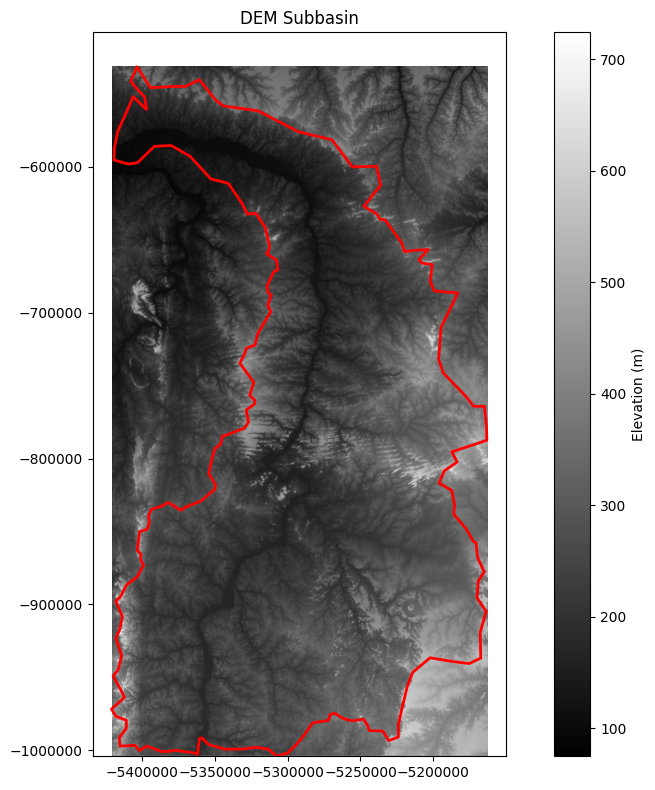

In [ ]:
# Display the DEM

fig, ax = plt.subplots(figsize=(10, 8))

# Plot with grayscale colormap ()
im = ax.imshow(dem_subbasin, cmap='gray',
               extent=[dem_subbasin.x.min(), dem_subbasin.x.max(),
                       dem_subbasin.y.min(), dem_subbasin.y.max()])

# Display the subbasin over
gdf_subbasin.to_crs(3857).plot(ax=ax, facecolor='none', edgecolor='red', linewidth=2)

# Add colorbar
cbar = plt.colorbar(im, ax=ax, label='Elevation (m)')

# Add title with CRS info
ax.set_title(f'DEM Subbasin')

# Optional: format coordinates with thousand separators
ax.ticklabel_format(style='plain', useOffset=False)

plt.tight_layout()
plt.show()

#### 7:  Compute streams (with Strahler orders) and catchments (further sub-basins) for the target area

Recommended station density can be expressed as Stations per basin area. But sub-dividing the basin into regular area units does not have much meaning hydrologically.

Therefore, creating units with hydrological meaning, like sub-catchments, are more suitable for an area-density analysis of the distribution of the stations.

The following analys takes the consideration a recommended density of stations provided by the user.

- Stations per sub-basin area
    e.g. 1 station per sub-catchment of 2000 km²
    - Therefore, choose a minimum area of 2000 for catchments in the following function:

In [ ]:
gdf_catchments, gdf_streams = pyflwdir_subbasins_minarea(dem_subbasin, gdf_subbasin, min_sto=4,
                                                         save_data=True,
                                                         file_name1=f'{ID_SUBBASIN}_catchments',
                                                         file_name2=f'{ID_SUBBASIN}_streams',
                                                         file_name3=f'{ID_SUBBASIN}_flowdir')

Choose the minimum area to delineate catchment areas (in km², max 71751). Type q to cancel and quit: 2000
Raster CRS: EPSG:3857
Input GeoDataFrame CRS: EPSG:4326
Reprojecting GeoDataFrame from EPSG:4326 to EPSG:3857
Calculating flow directions for the elevation data.
29 catchments computed.
Vectorizing streams.
Saving catchments of basin.
Saving streams of basin.
Saving flow direction raster.


#### 8:  Check station density for sub-catchments area size

The following utility function <font color='magenta'>analyse_station_density_catchments()</font> checks how many of stations are in each catchment, and display a map with the streams (styled according to their Strahler order), the catchments (styled according to the presence of stations).

In [ ]:
# ###############################################
# ### Loading data previously created, if needed:
# ###############################################

# gdf_catchments = gpd.read_file(f'outputs/{ID_SUBBASIN}_catchments_2000.geojson')
# gdf_streams = gpd.read_file(f'outputs/{ID_SUBBASIN}_streams.geojson')

# # Load stations with data
# # And strip time series from them, leaving only unique stations
# gdf_station_flow_series = gpd.read_file(f'outputs/{ID_SUBBASIN}_stations_flowseries.geojson')

# gdf_stations = (
#     gpd.GeoDataFrame(
#         gdf_station_flow_series[
#             ['codigoestacao', 'Operadora_Sigla', 'Municipio_Nome', 'geometry']
#         ]
#         .groupby('codigoestacao', as_index=False)
#         .last(),
#         geometry='geometry',
#         crs=gdf_station_flow_series.crs
#     )
# )

# # Load all stations
# gdf_stations_all = gpd.read_file(f'outputs/{ID_SUBBASIN}_stations_all.geojson')
# gdf_stations_all = (
#     gpd.GeoDataFrame(
#         gdf_stations_all[
#             ['codigoestacao', 'Operadora_Sigla', 'Municipio_Nome', 'geometry']
#         ]
#         .groupby('codigoestacao', as_index=False)
#         .last(),
#         geometry='geometry',
#         crs=gdf_stations_all.crs
#     )
# )

In [ ]:
# Sometimes the stations may be slightly outside our sub-basin area.
# One possibility is to snap them to our sub-basin
gdf_stations2 = snap_stations_polyg(gdf_stations, gdf_subbasin)

# Or alternatively eliminate those stations
# gdf_stations2 = gdf_stations.clip(gdf_subbasin)

# Perform count of stations per catchments, and display catchments
# coloured by either having or not having stations, streams coloured
# by their Strahler orders, and the stations. Optionally, can filter
# the streams to only be displayed over a certain strahler order (Standard: Strahler Order 6)
# Make sure that the geodataframes are in the same CRS
gdf_catchments, map = analyse_station_density_catchments(gdf_stations2.to_crs(3857),
                                                         gdf_subbasin.to_crs(3857),
                                                         gdf_catchments.to_crs(3857),
                                                         gdf_streams.to_crs(3857))

map

Stations have been snapped to the target geometry: 0.
Creating a Folium Map visualization.


d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.y.mean(),
d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:27: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.x.mean()


In comparison, the block below display all the stations retrieved for the sub-basin.
Usually, the stations have a much better distribution along the sub-basin.
But if we consider only the stations which data can be retrieved from, the robustness of the monitoring is much lower.

In [ ]:
# Filter stations that do not have data
gdf_stations_without_data = gdf_stations_all[~gdf_stations_all['codigoestacao'].isin(gdf_stations2['codigoestacao'])]


# Build a colormap for Streams, based on Strahler order
min_order = gdf_streams["strord"].min()
max_order = gdf_streams["strord"].max()
strord_cmap = cm.linear.Blues_09.scale(min_order, max_order)
strord_cmap.caption = "Strahler Order"

# Style function for the streams, displayed according to Strahler order
def stream_style_function(feature):
    order = feature["properties"]["strord"]

    return {
        "color": strord_cmap(order),
        "weight": order * 0.6,   # scale thickness
        "opacity": 0.9
    }


# Build a colormap for catchments, based in the existence or absence of stations on them
catch_cmap = cm.linear.RdYlGn_08.scale(0, 1)
catch_cmap.caption = "Stations on catchments"

# Style function for the catchments, displayed according to either having telemetering stations or not
def catchment_style_function(feature):
    has_stations = bool(feature["properties"]["count_st_cathcm"])

    return {
        "fillColor": catch_cmap(has_stations), # Color the catchments according to the presence or absence of stations
        "color": "black",
        "weight": 1,
        "fillOpacity": 0.5,
    }

# Filter which minimum stream Strahler Order will be displayed
gdf_streams_filtered = gdf_streams[gdf_streams["strord"] >= 6]

geojson_display_dicts = [
    {
        'data' : gdf_stations_without_data,
        'name' : 'Stations without data',
        'attribute_map' :
        {
            "codigoestacao": "Station ID",
            "Operadora_Sigla": "Responsable",
            "Municipio_Nome": "Municipality"
        },
        'feature_settings' : {}, #Point features, no style_function
        'marker': folium.Marker(icon=folium.Icon(icon="location-dot", prefix="fa", icon_color="red"))
    },
    {
        'data' : gdf_stations2,
        'name' : 'Stations with flow series',
        'attribute_map':
        {
            "codigoestacao": "Station ID",
            "Operadora_Sigla": "Responsable",
            "Municipio_Nome": "Municipality"
        },
        'feature_settings': {}, #Point features, no style_function
        'marker': folium.Marker(icon=folium.Icon(icon="location-dot", prefix="fa", icon_color="green"))
    },
    {
        'data' : gdf_subbasin,
        'name' : f'{ID_SUBBASIN}: {gdf_subbasins[gdf_subbasins['DNS_NU_SUB'] == int(ID_SUBBASIN)]['DNS_NM'].iloc[0]}',
        'attribute_map' :
        {
            "DNS_DNB_CD": "Code of the basin",
            "DNS_NU_SUB": "Code of the sub-basin",
            "DNS_NM": "Name"
        },
        'feature_settings':
        {
            "color": "red",
            "weight": 3,
            "fill": False
        }, # Sub-basin feature style
    },
    {
        'data' : gdf_catchments,
        'name' : 'Sub catchments',
        'attribute_map' :
        {
            "value": "#",
            "area_km2": "Area",
            "count_st_cathcm": "Station Count"
        },
        'feature_settings' : catchment_style_function, # Function to dinamically adjust the color of catchments
    },
    {
        'data' : gdf_streams_filtered,
        'name' : 'Streams',
        'attribute_map' :
        {
            "strord": 'Strahler Order'
        },
        'feature_settings' : stream_style_function, # Function to dinamically adjust width and color of streams absed on order
    }
]

# Plots both the filtered stations with data, and the respective sub-basin
display_Folium_map(geojson_display_dicts)

Creating a Folium Map visualization.


d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.y.mean(),
d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:27: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.x.mean()


Thus, by analysing these two displays, the decision maker could either propose new sites for
telemetering water stations, or to ensure data reactivation and availability of
stations that exist and are within catchments without water monitoring data.

#### 09:  River Network: Graph Structure and Upstream analysis from station locations 

Although stations per basin area or per sub-catchments are good metrics to analyse the distribution of the stations, it doesn't adress the actual upstream area that could be being surveyed by a given station.

Using the RiverNetwork class, the stream network with their Strahler order are translated into
a graph data structure, therefore allowing upstream for the stations within that network.

With the <font color='magenta'>snap_stations_streams()</font>, stations are snapped to close streams (up to a given tolerance, standard=150 meters). The snapped stations can become nodes of the River Graph Network later on.

In [ ]:
# Filter minimum Strahler Order to be displayed and analysed!
MIN_ORDER = 6
gdf_streams_filtered = gdf_streams[gdf_streams["strord"] >= MIN_ORDER]

# This step must be taken with care and consideration. Snapping stations to the
# streams is necessary for the following analysis with the river network as a Graph
# However, some stations may be snapped from too far or into a stream that was not
# its original one. If needed, drop some stations or relocate them into more suitable
# positions.
# Snap stations to the closest filtered streams
gdf_station_flow_series_snap2 = snap_stations_streams(gdf_stations, gdf_streams_filtered.explode())
gdf_stations_snap = gdf_station_flow_series_snap2.groupby(by='codigoestacao').last()
gdf_stations_snap = gdf_stations_snap.reset_index().set_crs(gdf_station_flow_series_snap2.crs) # Set CRS again since the groupy removes it.


Stations have been snapped to the target geometry: 8.


A <font color="magenta">RiverNetwork</font> class is instantiated.

Then, using <font color="magenta">split_streams_by_stations()</font>, stream segments are split
where stations intersect them. This step make sure that the Stations will become proper nodes of the Graph.

When a river network graph is created using <font color="magenta">create_graph()</font>, the stations that were used to split the stream network become part of the Graph as nodes. During this step, <font color='magenta'>fix_river_direction()</font> assures a right flow direction for the directed graph.

<font color="magenta">get_network_stats()</font> displays stats of the computed graph.

In [ ]:
# Initialize network
river_net = RiverNetwork(gdf_streams_filtered, gdf_stations_snap, strahler_col='strord')

# Split streams at stations
streams_split = river_net.split_streams_by_stations(
    tolerance=50,
    save_data=True,
    file_name= f'{ID_SUBBASIN}_streams_splitted_by_station'
)

# Create graph with automatic direction correction
G = river_net.create_graph(direction='downstream', fix_direction=True)

# Get statistics
stats = river_net.get_network_stats()
print("\nNetwork Statistics:")
for key, value in stats.items():
    print(f"  {key}: {value}")

RiverNetwork initialized with 6698 streams and 8 stations
Building spatial index for stations.
Splitting network on point intersection.
Saving split streams to d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\outputs
  Streams that were split: 5
Failed to get coordinates for geometry LINESTRING EMPTY, index out of range
River directions corrected based on Strahler order
Failed to process geometry at index 5003: index out of range
Graph created with 6703 nodes and 6702 edges
Stations found in graph: 5/8

Network Statistics:
  n_streams: 6698
  n_stations: 8
  n_streams_splitted: 6703
  n_nodes: 6703
  n_edges: 6702
  n_outlets: 1
  n_headwaters: 590
  n_station_nodes: 5


The RiverNetwork class has some methods to list and/or show which stations were included on its nodes (<font color="magenta">list_all_station_ids()</font> or <font color="magenta">get_station_nodes()</font>)

In [8]:
# List all station IDs
station_ids = river_net.list_all_station_ids()
print(f"\nAll station IDs in graph: {station_ids}")

# Get all station nodes
station_nodes = river_net.get_station_nodes()
print(f"Station nodes: {len(station_nodes)}")
for node, station_id in station_nodes.items():
    print(f"  Node {node}: Station {station_id}")



All station IDs in graph: ['23230000', '23251000', '23150000', '23650000', '23700000']
Station nodes: 5
  Node (-5261956.221061, -889581.872052): Station 23230000
  Node (-5275675.571573, -832821.872052): Station 23251000
  Node (-5317276.221061, -937517.625638): Station 23150000
  Node (-5236413.550351, -691239.201342): Station 23650000
  Node (-5284149.666795, -645508.426318): Station 23700000


The <font color="magenta">visualize_upstream_subgraph(station)</font> method plots the subgraphs, the target stations, and other stations upstream of this subgraph.

Upstream subgraph for station 23230000:
  Nodes: 422
  Edges: 421
  Stations: 1


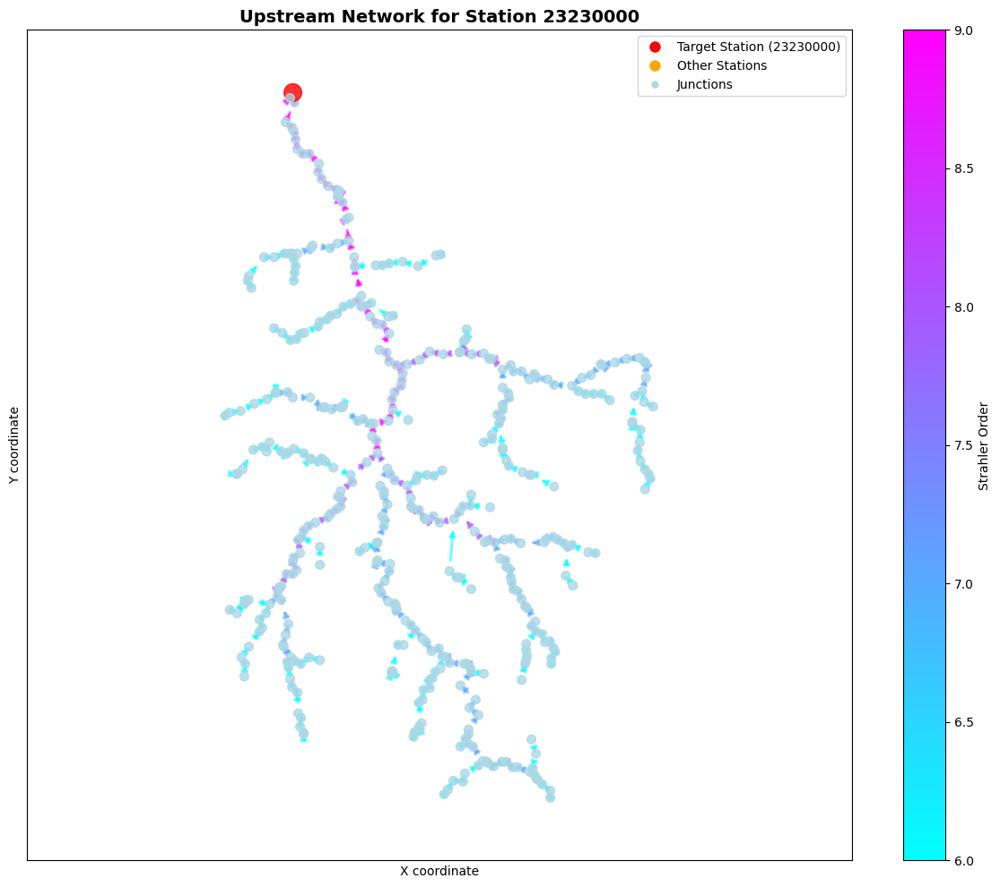

Upstream subgraph for station 23251000:
  Nodes: 117
  Edges: 116
  Stations: 1


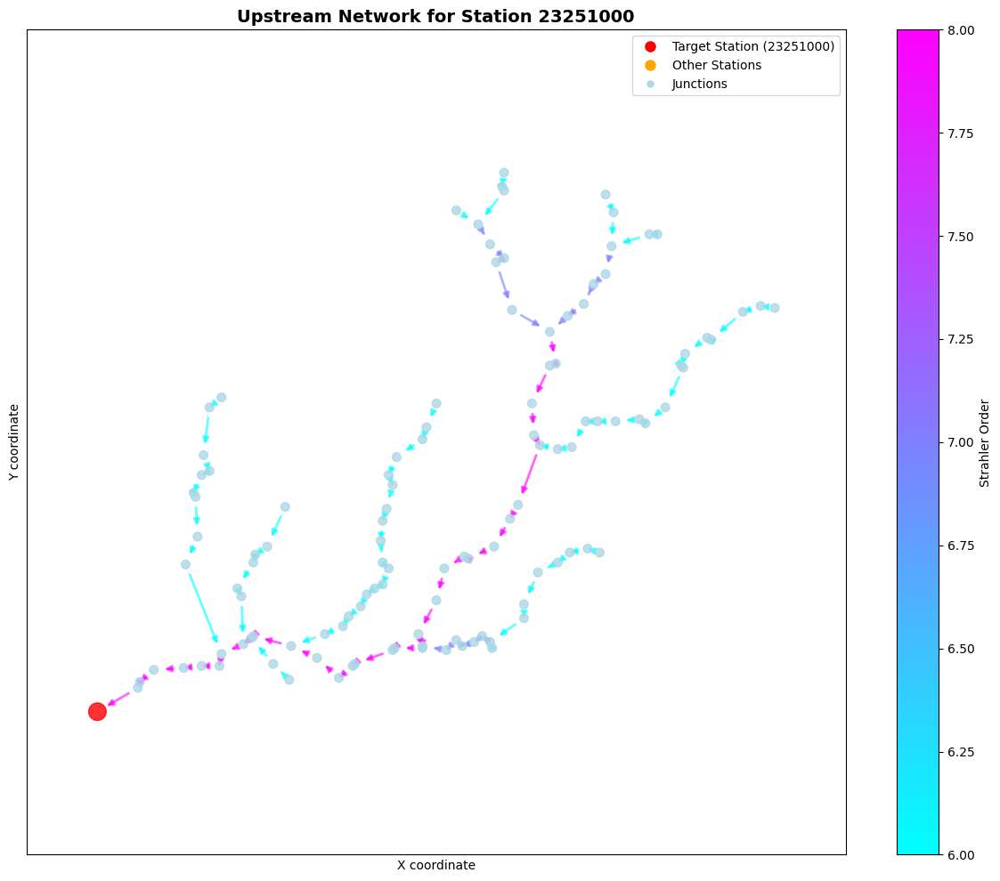

Upstream subgraph for station 23150000:
  Nodes: 242
  Edges: 241
  Stations: 1


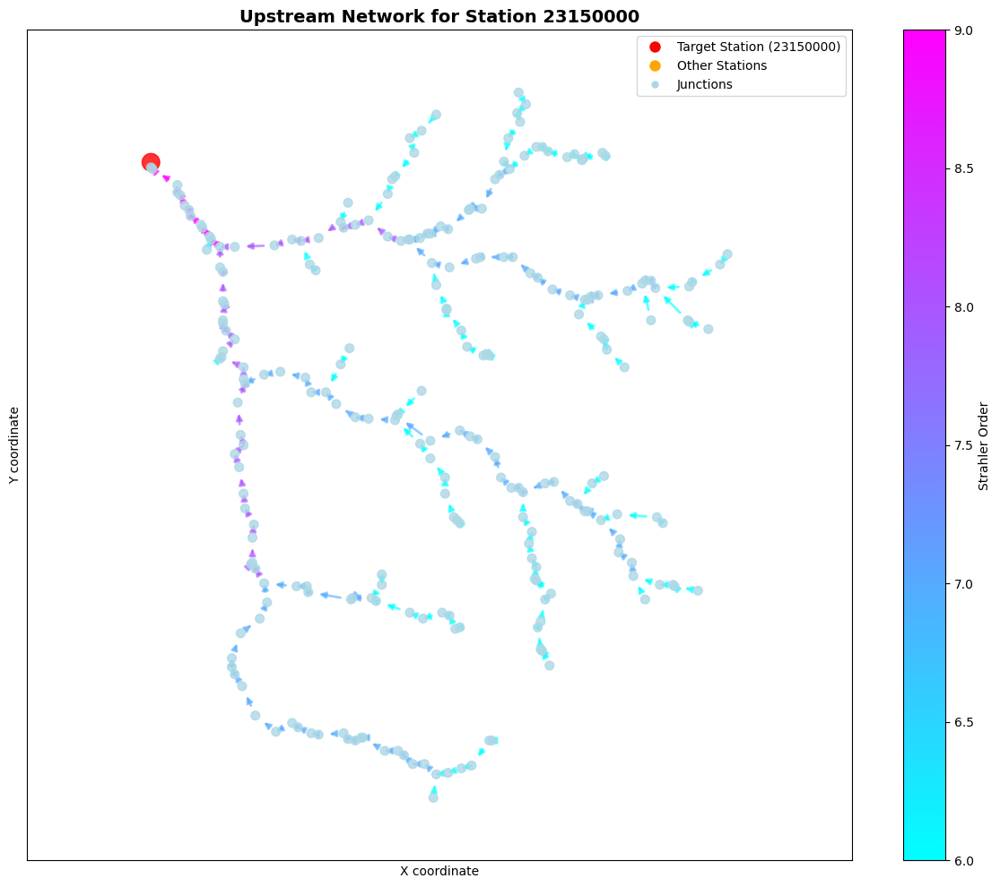

In [10]:
# Select some station id's for visualization
for station in station_ids[:3]:
    river_net.visualize_upstream_subgraph(station)

The utility <font color="magenta">analyse_station_upstream_network()</font> function runs the <font color="magenta">get_upstream_geodataframe()</font>, method, which gets a GeoDataFrame from <font color="magenta">get_upstream_subgraph()</font>. The later computes a upstream subgraph for each station.


It creates a visualization of what cumulative flow and stream network each station would
capture.

In [5]:
# Compute lengths of river networks monitored by the stations, according to their Strahler Order
# Create colormaps for each sub-graph of river networks and
# display the data into a Folium Map
# Make sure that the geodataframes are in the same CRS
gdf_station_upstreams, map = analyse_station_upstream_network(river_net,
                                       gdf_subbasin.to_crs(3857),
                                       gdf_stations_snap.to_crs(3857),
                                       gdf_catchments.to_crs(3857),
                                       gdf_streams.to_crs(3857))

map

Upstream subgraph for station 23230000:
  Nodes: 422
  Edges: 421
  Stations: 1
Upstream network for station 23230000: 421 edges
Upstream subgraph for station 23251000:
  Nodes: 117
  Edges: 116
  Stations: 1
Upstream network for station 23251000: 116 edges
Upstream subgraph for station 23150000:
  Nodes: 242
  Edges: 241
  Stations: 1
Upstream network for station 23150000: 241 edges
Upstream subgraph for station 23650000:
  Nodes: 11
  Edges: 10
  Stations: 1
Upstream network for station 23650000: 10 edges
Upstream subgraph for station 23700000:
  Nodes: 5797
  Edges: 5796
  Stations: 5
Upstream network for station 23700000: 5796 edges
Creating a Folium Map visualization.


d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:31: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.y.mean(),
d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:32: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.x.mean()


The utility <font color="magenta">analyse_station_influence_zone()</font> function runs both <font color="magenta">compute_station_influence_zones()</font> (which computes which parts of the graphs are within a maximum cumulative length starting from each station) and the <font color="magenta">get_station_influence_geodataframe()</font> (which returns the GeoDataFrame) of the influence zone for each station.

The visualization it creates gives an idea of how much of the river network is close or not to a neighbour station.

In [6]:
# Compute influence zones of monitoring for each station, based on recommended maximum
# river length that should be monitored by them.

# Display the data into a Folium Map
# Make sure that the geodataframes are in the same CRS
gdf_influence_zones, map = analyse_station_influence_zone(river_net,
                                                          gdf_subbasin.to_crs(3857),
                                                          gdf_stations_snap.to_crs(3857),
                                                          gdf_catchments.to_crs(3857),
                                                          gdf_streams.to_crs(3857))

map

Computing influence zones for 5 stations...
Maximum upstream distance: 100 km

Processing station 23230000...
  Station 23230000: 233 nodes within 100 km

Processing station 23251000...
  Station 23251000: 117 nodes within 100 km

Processing station 23150000...
  Station 23150000: 242 nodes within 100 km

Processing station 23650000...
  Station 23650000: 11 nodes within 100 km

Processing station 23700000...
  Station 23700000: 536 nodes within 100 km

=== Influence Zone Summary ===
Nodes assigned to stations: 1139/6703 (17.0%)
Influence zone for station 23230000: 232 edges
Influence zone for station 23251000: 116 edges
Influence zone for station 23150000: 241 edges
Influence zone for station 23650000: 10 edges
Influence zone for station 23700000: 535 edges
Creating a Folium Map visualization.


d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:31: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.y.mean(),
d:\Flávio Rocha USER\OneDrive\GIT\SNIRH-Water-Station-Distribution\src\utils.py:32: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  geojson_display_dicts[0]['data'].geometry.centroid.x.mean()


#### 10:  Data visualization - Pairplot representation

After computing catchments, streams, checking the count of stations in each sub-basin/catchment,
and the river network computing and analysis, some spatial join operations are performed to create potentially relevant data to be seen and analysed.

##### <font color='magenta'>Computing some attributes for data analysis and data visualization - gdf_catchments</font>
Perform spatial join to relate catchments, streams and stations.

In [ ]:
#######################################################
# Computing some attributes for data analysis and data visualization - gdf_catchments
# Perform spatial join to relate streams and stations
#######################################################
gdf_catchments_dt = gdf_catchments.copy()

############
# Computing total length of streams in each catchment
############
# Compute length of the streams
gdf_streams_filtered['length_km'] = gdf_streams_filtered.geometry.length/1000
# Relate streams to catchments through spatial joint
joined = gpd.sjoin(gdf_streams_filtered, gdf_catchments_dt, how='left', predicate='within')
# Group by polygon index and sum the lengths
length_per_polygon = joined.groupby('index_right')['length_km'].sum()
# Add the summed lengths back to the polygons GeoDataFrame
gdf_catchments_dt['tot_stream_len_km'] = gdf_catchments_dt.index.map(length_per_polygon).fillna(0)

############
# Computing cummulative river length in each sub-catchment
############
# Basic conversion of stream network with cumulative length from headwaters
gdf_streams_cummulative = river_net.graph_to_geodataframe(
    include_cumulative_length=True,
    direction='downstream'
)

# Perform correction in cumulative len calculated through _add_cumulative_length
gdf_streams['length_km'] = gdf_streams.to_crs(3857).geometry.length/1000
total_len = gdf_streams['length_km'].sum()
total_cum_len = gdf_streams_cummulative.sort_values(by=['cumulative_length'], ascending=False)['cumulative_length'].iloc[0]
factor = total_len/total_cum_len
gdf_streams_cummulative['cumulative_length_km'] = gdf_streams_cummulative['cumulative_length']*factor

# Spatial join between catchments and streams with cummulative length values
gdf_catchments_dt["cumulative_length_km"] = (
    gpd.sjoin(
        gdf_streams_cummulative.to_crs(3857),
        gdf_catchments_dt.to_crs(3857),
        predicate="within"
    )
    .groupby("index_right")["cumulative_length_km"]
    .max()
    .reindex(gdf_catchments_dt.index, fill_value=0)
)

############
# Counting number of stations within each sub-catchment
############
gdf_catchments_dt["count_st_cathcm"] = (
    gpd.sjoin(gdf_stations.to_crs(3857),
            gdf_catchments_dt.to_crs(3857), predicate="within")
    .groupby("index_right")
    .size()
    .reindex(gdf_catchments_dt.index, fill_value=0)
)

############
# Computing total length of streams within influence zone of stations in each sub-catchment
############
# Calculate length of streams in influence zone
gdf_influence_zones['length_km'] = gdf_influence_zones.to_crs(3857).geometry.length/1000

# Relate streams to catchments through spatial joint
joined = gpd.sjoin(gdf_influence_zones, gdf_catchments_dt, how='left', predicate='within')

# Group by polygon index and sum the lengths
length_per_polygon = joined.groupby('index_right')['length_km'].sum()

# Add the summed lengths back to the polygons GeoDataFrame
gdf_catchments_dt['total_influzone_len_km'] = gdf_catchments_dt.index.map(length_per_polygon).fillna(0)


############
# Computing total length of streams in a catchment that has a station downstream
############
gdf_station_upstreams['length_km'] = gdf_station_upstreams.to_crs(3857).geometry.length/1000
# Aggregate gdf_station_upstreams so each upstream network shared between two stations is aggregated
# into a collection of stations downstream of that segment 
gdf_station_upstreams_agg = (
    gdf_station_upstreams
    .groupby("geometry", as_index=False)
    .agg({
        "dwnstream_stat": lambda x: tuple(x),
        "length_km": "first"
    })
)

# Transform the DataFrame into a GeoDataFrame again
gdf_station_upstreams_agg = gpd.GeoDataFrame(gdf_station_upstreams_agg,geometry="geometry",crs=gdf_station_upstreams.crs)

# Relate streams to catchments through spatial joint
joined = gpd.sjoin(gdf_station_upstreams_agg, gdf_catchments_dt, how='left', predicate='within')

# Group by polygon index and sum the lengths
# A column of length sums will be created for each number of stations that are downstream of it
upstr_dic = {}
for uni in joined['dwnstream_stat'].unique():
    upstr_dic[len(uni)] = upstr_dic.get(len(uni), [])
    upstr_dic[len(uni)].append(uni)

for l in upstr_dic:
    length_per_polygon = joined[joined['dwnstream_stat'].isin(upstr_dic[l])].groupby('index_right')['length_km'].sum()
    gdf_catchments_dt[f'tot_len_monit_{l}_stat'] = (length_per_polygon
                                                 .reindex(gdf_catchments_dt.index, fill_value=0))


############
# Computing total length of streams in a catchment that have not a station downstream
############
gdf_catchments_dt['tot_len_not_monit'] = gdf_catchments_dt['tot_stream_len_km'] - gdf_catchments_dt['tot_len_monit_1_stat'] - gdf_catchments_dt['tot_len_monit_2_stat']

##### <font color='magenta'>Displaying the visualization with seaborn</font>



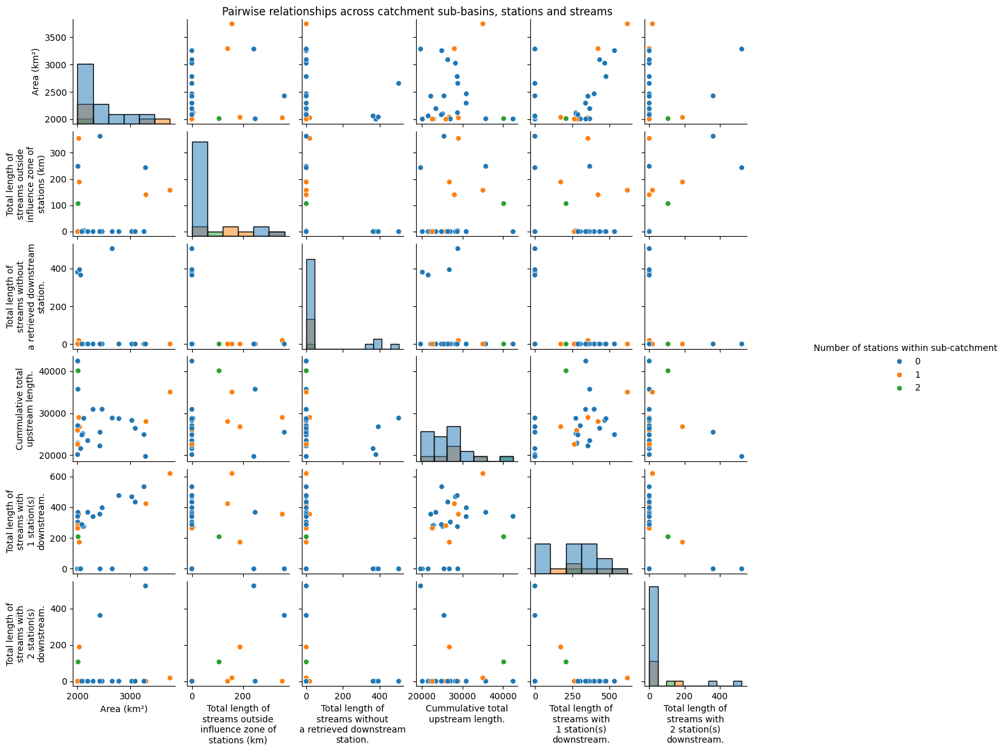

In [ ]:
# To better display the labels of the axis, a dictionary is created to map each column name to a label name for displaying
axis_labels = {
    'area_km2': 'Area (km²)',
    'total_influzone_len_km': 'Total length of\nstreams outside\ninfluence zone of\nstations (km)',
    'tot_len_not_monit': 'Total length of\nstreams without\na retrieved downstream\nstation.',
    'cumulative_length_km' : 'Cummulative total\nupstream length.'
    }
for l in upstr_dic:
    axis_labels[f'tot_len_monit_{l}_stat'] = f'Total length of\nstreams with\n{l} station(s)\ndownstream.'

######### A pair plot will be displayed for pairwise visualization
cols = [col for col in axis_labels]
cols.append('count_st_cathcm')
sub_gdf = gdf_catchments_dt[cols]

# Define palette for plot
num_classes = len(gdf_catchments_dt['count_st_cathcm'].unique())
palette = sns.color_palette("tab10", num_classes)

# Corner is set true so we visualize only half of the plot-array (since it's symmetric, only half of it is necesssary).
pp = sns.pairplot(sub_gdf, height=2, hue='count_st_cathcm', palette=palette, diag_kind='hist')
pp.legend.set_title('Number of stations within sub-catchment') #'Cumulative river network length in the sub-catchment (km)')

# By iterating through the axes of the pp PairGrid object, the designed label is assigned for each ax/axes
for ax in pp.axes.flatten():
    if ax is not None:
        xlabel = ax.get_xlabel()
        ylabel = ax.get_ylabel()

        if xlabel in axis_labels:
            ax.set_xlabel(axis_labels[xlabel])
        if ylabel in axis_labels:
            ax.set_ylabel(axis_labels[ylabel])

# Add title with custom formatting
pp.fig.suptitle(
    'Pairwise relationships across catchment sub-basins, stations and streams',
    fontsize=16,           # Larger font size
    fontweight='bold',     # Bold text
    y=1.02                 # Move higher (default is ~0.98, >1.0 moves it above the plot)
)

# Move legend below the plots
pp.legend.set_bbox_to_anchor((0.95, 0.5))
pp.legend.set_loc("center left")

# Adjust layout to make room for the title
pp.fig.subplots_adjust(top=0.96, right=0.85)  # Added top parameter

pp.tight_layout()